<a href="https://colab.research.google.com/github/Bozo4Hire/CDSI_2026/blob/main/s3_procesamiento_audio_nogc.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Notebook de procesamiento de Audio**
### Ciencia de Datos para Sensores Inteligentes
*Alumno: Norman O. Guzmán Chaboya*

El siguiente notebook tiene el objetivo de explorar algunas de las funciones de las siguientes librerías para el tratamiento de audio:

* pydub: edición básica
* soundfile: lectura y escritura
* librosa: análisis y procesamiento
* IPython.display.Audio: reproducción interactiva de audio
* scipy.signal: procesamiento digital de señales
* whisper: reconocimiento automático del habla
* essentia.standard: librería para análisis avanzado de audio

In [53]:
# montando directorio de drive
from google.colab import drive
drive.mount('/content/drive/')

%cd  '/content/drive/MyDrive/CDSI/s3_procesamiento_audio'

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
/content/drive/MyDrive/CDSI/s3_procesamiento_audio


Procedo a instalar un par de librerías con las que Google Colab no cuenta por defecto (Essentia y Whisper de OpenAI)

In [54]:
#!pip install -U openai-whisper
!pip install essentia

Cargamos todas las librerías

In [55]:
import numpy as np
import matplotlib.pyplot as plt

from pydub import AudioSegment

import soundfile as sf

import librosa
import librosa.display

from IPython.display import Audio

from scipy import signal

import whisper

import essentia.standard as es

Para cargar un audio (archivo .mp3) y posteriormente exportarlo a un tipo de archivo más manejable (.wav), se utiliza PyDub

In [56]:
sound = AudioSegment.from_mp3('./Sweetest_Chill.mp3')
sound.export("./Sweetest_Chill.wav", format="wav")

<_io.BufferedRandom name='./Sweetest_Chill.wav'>

Librosa también permite cargar audios directamente al script

In [57]:
filename = './Sweetest_Chill.wav'
data, sr = librosa.load(filename)

IPython.display permite crear un elemento interactivo que hace posible reproducir audios dentro del notebook.

In [58]:
print(f"Tasa de sampleo: {sr}\n")
Audio(data, rate=sr)

Tasa de sampleo: 22050



Librosa tiene una utilidad que permite visualizar la forma de onda de un audio pre-cargado, que representa la amplitud de la señal en el tiempo.

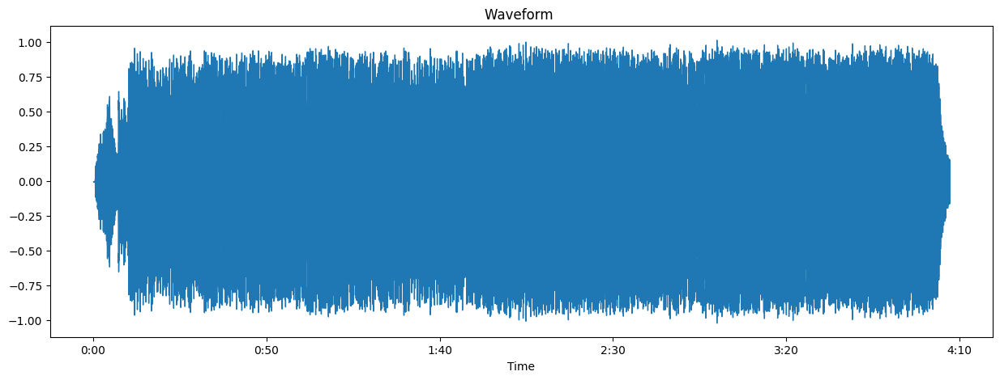

In [59]:
plt.figure(figsize=(15,5))
librosa.display.waveshow(data, sr=sr)
plt.title("Waveform ")
plt.show()

Un audio puede simplemente recortarse de la siguiente manera, normalizando sobre su frecuencia de muestreo. En este caso, el corte se hace entre los segundos 86 y 131.

In [60]:
data_trimmed = data[int(86*sr):int(131*sr)]

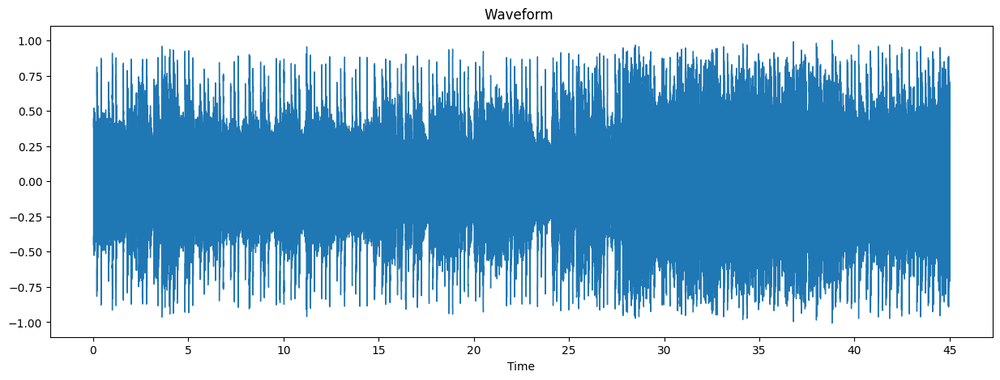

Tasa de sampleo: 22050



In [61]:
plt.figure(figsize=(15,5))
librosa.display.waveshow(data_trimmed, sr=sr)
plt.title("Waveform ")
plt.show()

print(f"Tasa de sampleo: {sr}\n")
Audio(data_trimmed, rate=sr)


Usando funciones de Librosa, se define la siguiente que permite graficar espectogramas de Mel de audios

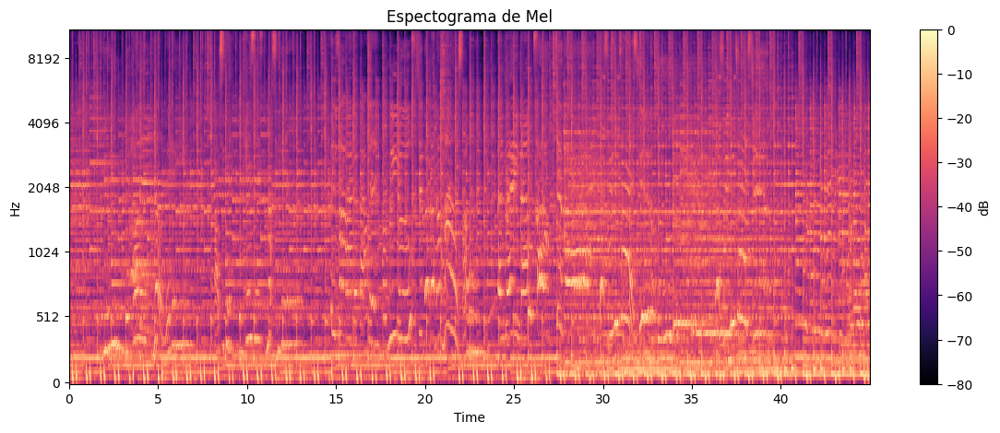

In [62]:
def plot_mel_spectogram(data, sr):
  # función de librosa para calcular espectograma de Mel
  spec = librosa.feature.melspectrogram(
    y=data,
    sr=sr,
    n_mels=128,
    n_fft=2048,
    hop_length=512
  )

  #cConvierte el espectrograma de potencia a escala logarítmica
  spec_db = librosa.power_to_db(spec, ref=np.max)

  plt.figure(figsize=(14, 5))
  librosa.display.specshow(spec_db,sr=sr,hop_length=512,x_axis="time",y_axis="mel")

  plt.colorbar(label="dB")
  plt.title("Espectograma de Mel")
  plt.show()
plot_mel_spectogram(data_trimmed,sr)

Esta función de librosa permite estirar un audio en función de tiempo, cómo este caso que la velocidad se "aumentó" al doble

In [63]:

data_stretched = librosa.effects.time_stretch(data_trimmed, rate=2)

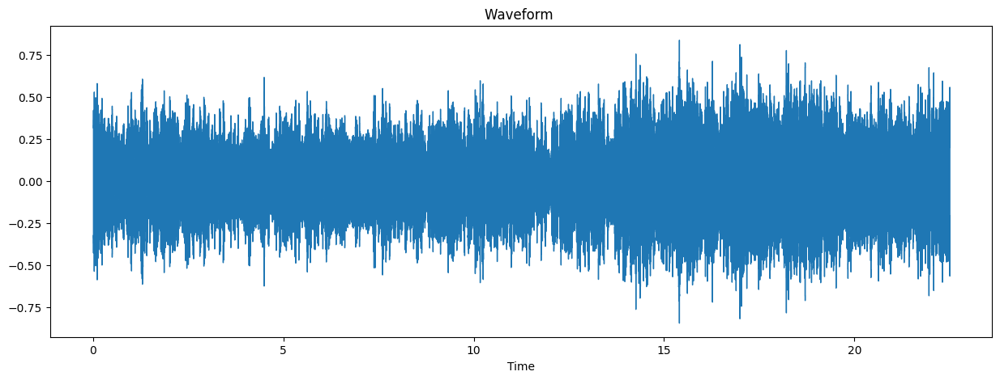

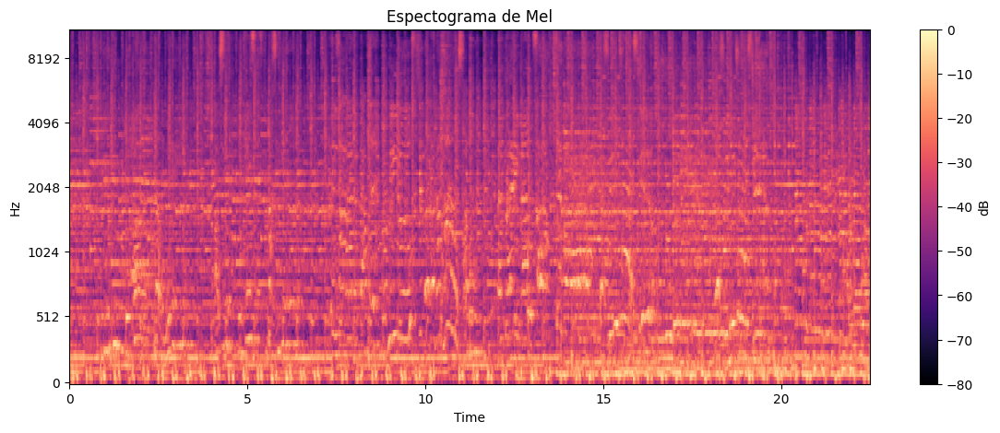

In [64]:
plt.figure(figsize=(15,5))
librosa.display.waveshow(data_stretched, sr=sr)
plt.title("Waveform ")
plt.show()

plot_mel_spectogram(data_stretched,sr)

Audio(data_stretched, rate=sr)

Una de las cosas que Scipy.signal permite hacer es aplicar filtros pasa bandas. Particularmente aquí, se aplicó un filtro Butterworth que mantiene la frecuencias entre los 100 y 2500 Hz

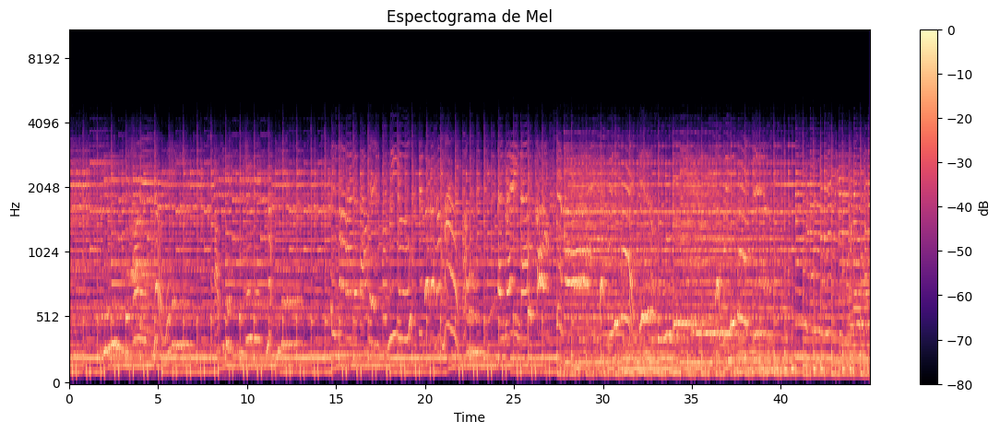

In [65]:
bandpass = signal.butter(N=6, Wn=[100, 2500], btype="bandpass",fs=sr,output="sos")

data_vocals = signal.sosfilt(bandpass, data_trimmed)
plot_mel_spectogram(data_vocals,sr)
Audio(data_vocals, rate=sr)

# Whisper (provista por OpenAI) permite acceso a un modelo de reconocimiento de habla, el cual se aplicó a uno de los fragmentos de la canción (nótese que en el silencio inicial se interpreta como si se cantara en japonés)

In [15]:
model = whisper.load_model("base")

result = model.transcribe("./Sweetest_Chill.wav")

print(result["text"])

100%|███████████████████████████████████████| 139M/139M [00:01<00:00, 96.5MiB/s]
/usr/local/lib/python3.12/dist-packages/whisper/transcribe.py:132: UserWarning: FP16 is not supported on CPU; using FP32 instead
  warnings.warn("FP16 is not supported on CPU; using FP32 instead")


spam Late tanきっとゾンレうファンジン Without youth messages to those sprueYear bybearacequn gesture beimemememememememememeI knew it was too far enough to hearWatching you, watching you, watching you, watching you, watching youWe're ever strange, come to the worldWe're best of music, so it's wrong to ever hear itWe're always strange, come to the worldWe're always strange, come to the worldWe're always strangeI'm strange, come to the worldWe're always strange, come to the worldWe're always strangeWe're always strange, come to the world


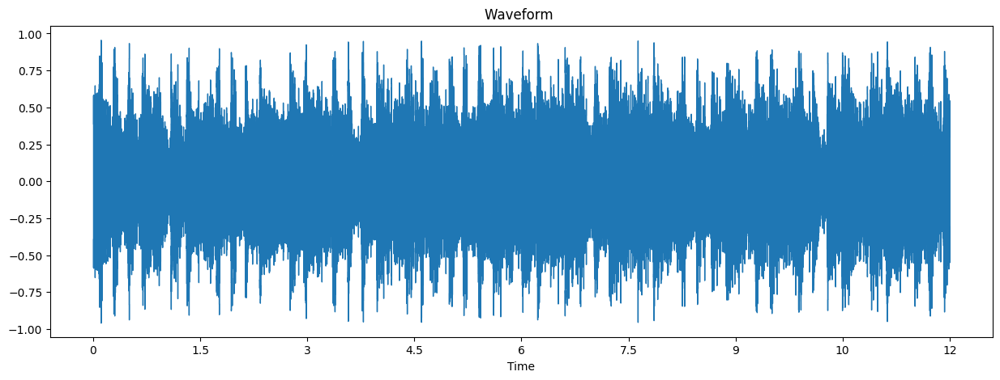

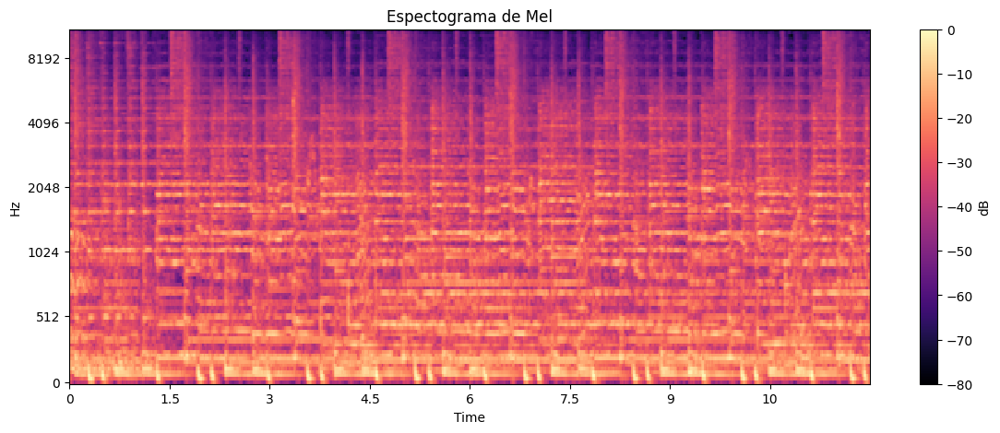

In [66]:
data_chords_iliked = data[int(203*sr):int(215*sr)]

sf.write('chords.wav', data_chords_iliked, sr)
plt.figure(figsize=(15,5))
librosa.display.waveshow(data_chords_iliked, sr=sr)
plt.title("Waveform ")
plt.show()

plot_mel_spectogram(data_chords_iliked,sr)

Audio(data_chords_iliked, rate=sr)

Essence tiene todo un crisol de modelos para el análisis de audio, detectando variables como valencia, género y escala, como se ha procesado aquí abajo

In [67]:
chord_audio = es.MonoLoader(filename="chords.wav")()

key, scale, strength = es.KeyExtractor(profileType="edma")(
    chord_audio
)

print(key, scale, strength)

F minor 0.7588087916374207
